<a href="https://colab.research.google.com/github/emsieler/Sketch-to-Video/blob/sketchtoimage/04_22_932_Copy_of_Sketch_to_Image.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

[Paper](https://www.researchgate.net/publication/362481944_Sketch_to_Image_Using_Generative_Adversarial_Networks_GAN)

In [ ]:
#changes april 22 9:32 pm

import torch
import torch.nn as nn
import torchvision.transforms as transforms

# Generator with 3-channel input
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        # Encoder: Downsample the input sketch to extract features
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1),  # 3 (RGB) -> 64
            nn.BatchNorm2d(64), #dont use batch norm here ?? according to paper
            nn.LeakyReLU(0.2),

            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),  # 64 -> 128
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),

            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),  # 128 -> 256
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),

            nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1),  # 256 -> 512
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2),
        )

        # Decoder: Upsample to generate the output image
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1),  # 512 -> 256
            nn.BatchNorm2d(256),
            nn.ReLU(),

            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),  # 256 -> 128
            nn.BatchNorm2d(128),
            nn.ReLU(),

            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),  # 128 -> 64
            nn.BatchNorm2d(64),
            nn.ReLU(),

            nn.ConvTranspose2d(64, 3, kernel_size=4, stride=2, padding=1),  # 64 -> 3 (RGB output)
            nn.Tanh()  # Output scaled to [-1, 1] for GAN compatibility
        )

    def forward(self, x):
        # Pass through encoder, then decoder
        encoded_features = []
        for layer in self.encoder:
          x = layer(x)
          encoded_features.append(x)

        for idx, layer in enumerate(self.decoder):
          x = layer(torch.cat([x, encoded_features.pop()], dim=1))

        return x

In [ ]:
import sklearn
import numpy as np
import cv2
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.optim as optim
import torch.backends.cudnn as cudnn
import torchvision
import time
import os
import random

from sklearn.cluster import KMeans
from torch.optim import lr_scheduler
from torchvision import datasets, models, transforms
from google.colab.patches import cv2_imshow
from torch.utils.data import DataLoader, Dataset


In [ ]:
from google.colab import drive
drive.mount('/content/drive') #only needs to be run once

In [ ]:
!ls '/content/drive/MyDrive/Applied CV Project/Sketch to Image/datasets/sketchy_dataset'

photo  sketch


In [ ]:
drive_path = '/content/drive/MyDrive/Applied CV Project/Sketch to Image/datasets/sketchy_dataset' #put all datasets in datasets folder!!

In [ ]:
!ls "$drive_path/photo/matches_sketch"

crocodilian  fish  frog  lizard  owl  ray  sea_turtle  shark  snake  songbird  turtle


In [ ]:
!ls "$drive_path/sketch/tx_000000000010"

crocodilian  fish  frog  lizard  owl  ray  sea_turtle  shark  snake  songbird  turtle


In [ ]:
photo_dir_owl = '/content/drive/MyDrive/Applied CV Project/Sketch to Image/datasets/sketchy_dataset/photo/matches_sketch/owl'
sketch_dir_owl = '/content/drive/MyDrive/Applied CV Project/Sketch to Image/datasets/sketchy_dataset/sketch/tx_000000000010/owl'

In [ ]:
import os
from PIL import Image
import torch
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms

class SketchPhotoDataset(Dataset):
    def __init__(self, sketch_dir, photo_dir, transform=None):
        self.sketch_dir = sketch_dir
        self.photo_dir = photo_dir
        self.transform = transform

        self.sketch_files = sorted(os.listdir(self.sketch_dir))
        self.photo_files = sorted(os.listdir(self.photo_dir))

    def __len__(self):
        return len(self.sketch_files)

    def __getitem__(self, idx):
        sketch_path = os.path.join(self.sketch_dir, self.sketch_files[idx])
        photo_path = os.path.join(self.photo_dir, self.photo_files[idx])

        sketch = Image.open(sketch_path)
        photo = Image.open(photo_path)

        if self.transform:
            sketch = self.transform(sketch)
            photo = self.transform(photo)

        return sketch, photo

# Define transformations to be applied on the images
transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Resize to a common size
    transforms.ToTensor(),          # Convert to tensor
])

# Define the directories for sketches and photos
photo_dir_owl = '/content/drive/MyDrive/Applied CV Project/Sketch to Image/datasets/sketchy_dataset/photo/matches_sketch/owl'
sketch_dir_owl = '/content/drive/MyDrive/Applied CV Project/Sketch to Image/datasets/sketchy_dataset/sketch/tx_000000000010/owl'

# Create the dataset and dataloader
dataset = SketchPhotoDataset(sketch_dir_owl, photo_dir_owl, transform)
dataloader = DataLoader(dataset, batch_size=32, shuffle=True)

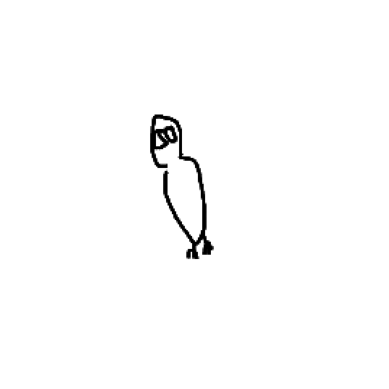

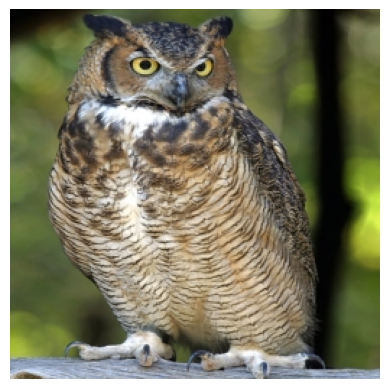

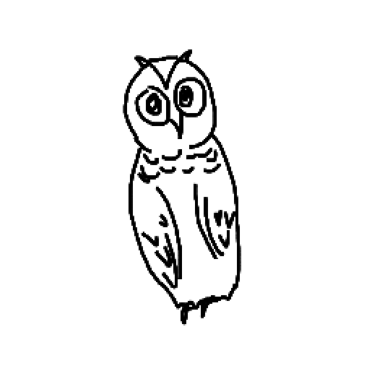

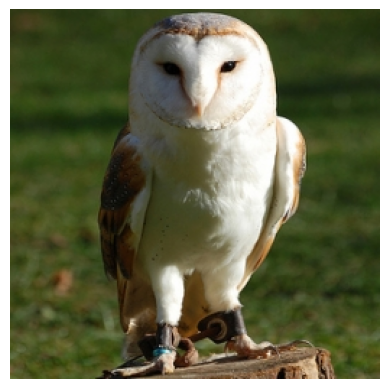

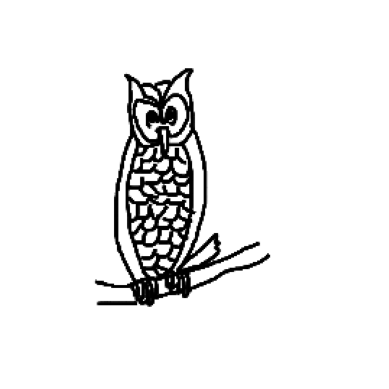

...

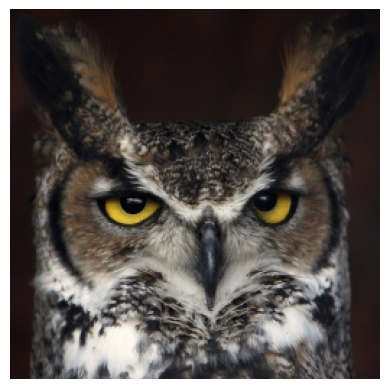

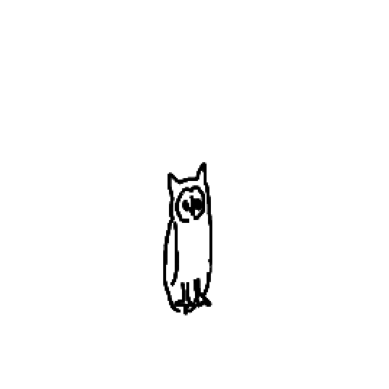

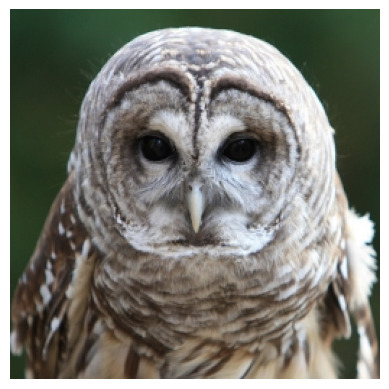

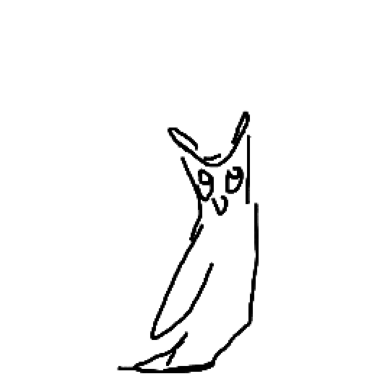

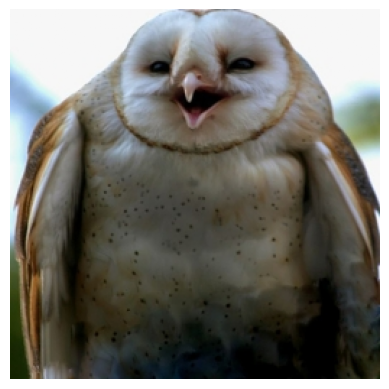

In [ ]:
for i in dataset:
  for j in i:
    plt.imshow(j.permute(1, 2, 0))  # Use colormap if grayscale
    plt.axis('off')  # Hide the axis
    plt.show()

In [ ]:
import os
from PIL import Image  # Use PIL for image handling
import torch
import torchvision.transforms as transforms

# Define a function to load images into a PyTorch-compatible format
def load_images(data_dir, target_size):
    all_images = {}
    class_names = sorted(os.listdir(data_dir))  # List of class folders (animal types)

    # Define the transformation: resize to target size and convert to tensor
    transform = transforms.Compose([
        transforms.Resize(target_size),  # Resize images
        transforms.ToTensor(),          # Convert to PyTorch tensor
    ])

    # Loop through each class folder
    for class_idx, class_name in enumerate(class_names):
        images = []
        folder_path = os.path.join(data_dir, class_name)
        for file in os.listdir(folder_path):
            if file.endswith(('.jpg', '.png', '.jpeg')):  # Check valid image formats
                image_path = os.path.join(folder_path, file)
                # Open image with PIL, apply transform, and convert to tensor
                image = Image.open(image_path)
                image = transform(image)  # Apply transformation
                images.append(image)  # Add the tensor to the list
        # Convert list of tensors to a tensor stack
        print(len(images), class_name)
        all_images[class_idx] = torch.stack(images)  # Stack tensors along a new dimension

    return all_images

In [ ]:
data_dir = 'drive/MyDrive/Applied CV Project/Sketch to Image/datasets/sketchy_dataset/'
photo_dir = 'drive/MyDrive/Applied CV Project/Sketch to Image/datasets/sketchy_dataset/photo/matches_sketch'
sketch_dir = 'drive/MyDrive/Applied CV Project/Sketch to Image/datasets/sketchy_dataset/sketch/tx_000000000010'

In [ ]:
photo_images = load_images(photo_dir, (256, 256))

100 crocodilian
100 fish
100 frog
100 lizard
100 owl
100 ray
100 sea_turtle
100 shark
100 snake
100 songbird
100 turtle


In [ ]:
sketch_images = load_images(sketch_dir, (256, 256))

In [ ]:
plt.imshow(photo_images[0][0].permute(1, 2, 0).numpy())
plt.axis("off")
plt.show()

In [ ]:
plt.imshow(sketch_images[0][0].permute(1, 2, 0).numpy())
plt.axis("off")
plt.show()

In [ ]:
from torchvision import transforms
import torch

# Define transformations for tensors
transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Adjust if needed
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),  # Normalize with suitable mean and std dev
])

class SketchToImageDataset(Dataset):
    def __init__(self, sketch_dict, image_dict, transform=None):
        self.sketch_dict = sketch_dict
        self.image_dict = image_dict
        self.transform = transform

        # Determine common pairs
        self.common_pairs = []
        common_categories = set(sketch_dict.keys()).intersection(set(image_dict.keys()))

        for category in common_categories:
            min_count = min(len(sketch_dict[category]), len(image_dict[category]))
            self.common_pairs.extend([(sketch_dict[category][i], image_dict[category][i]) for i in range(min_count)])

        # Shuffle pairs for randomization
        random.shuffle(self.common_pairs)

    def __len__(self):
        return len(self.common_pairs)

    def __getitem__(self, idx):
        sketch, image = self.common_pairs[idx]

        # Apply transformations only if needed
        if self.transform:
            sketch = self.transform(sketch)
            image = self.transform(image)

        return (sketch, image)

In [ ]:
# Instantiate your dataset with sketches and images
dataset = SketchToImageDataset(sketch_dict=sketch_images, image_dict=photo_images, transform=transform)

# Create a DataLoader with batch size, shuffle, etc.
data_loader = DataLoader(dataset, batch_size=16, shuffle=True)

In [ ]:
import torch
import torch.nn as nn
import torchvision.transforms as transforms

# Generator with 3-channel input
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        # Encoder: Downsample the input sketch to extract features
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1),  # 3 (RGB) -> 64
            nn.BatchNorm2d(64), #dont use batch norm here ?? according to paper
            nn.LeakyReLU(0.2),

            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),  # 64 -> 128
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),

            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),  # 128 -> 256
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),

            nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1),  # 256 -> 512
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2),

            nn.Conv2d(512, 1024, kernel_size=4, stride=2, padding=1),  # 512 -> 1024
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(0.2),

            nn.Conv2d(1024, 2048, kernel_size=4, stride=2, padding=1),  # 1024 -> 2048
            nn.BatchNorm2d(2048),
            nn.LeakyReLU(0.2),

            nn.Conv2d(2048, 4096, kernel_size=4, stride=2, padding=1),  # 2048 -> 4096
            nn.BatchNorm2d(4096),
            nn.LeakyReLU(0.2),

        )

        # Decoder: Upsample to generate the output image
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(4096, 2048, kernel_size=4, stride=2, padding=1),  # 4096 -> 2048
            nn.BatchNorm2d(256),
            nn.ReLU(),

            nn.ConvTranspose2d(2048, 1024, kernel_size=4, stride=2, padding=1),  # 2048 -> 1024
            nn.BatchNorm2d(256),
            nn.ReLU(),

            nn.ConvTranspose2d(1024, 512, kernel_size=4, stride=2, padding=1),  # 1024 -> 256
            nn.BatchNorm2d(256),
            nn.ReLU(),

            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1),  # 512 -> 256
            nn.BatchNorm2d(256),
            nn.ReLU(),

            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),  # 256 -> 128
            nn.BatchNorm2d(128),
            nn.ReLU(),

            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),  # 128 -> 64
            nn.BatchNorm2d(64),
            nn.ReLU(),

            nn.ConvTranspose2d(64, 3, kernel_size=4, stride=2, padding=1),  # 64 -> 3 (RGB output)
            nn.Tanh()  # Output scaled to [-1, 1] for GAN compatibility
        )

    def forward(self, x):
        # Pass through encoder, then decoder
        encoded_features = []
        for layer in self.encoder:
          x = layer(x)
          encoded_features.append(x)

        for idx, layer in enumerate(self.decoder):
          x = layer(torch.cat([x, encoded_features.pop()], dim=1))

        return x

In [ ]:
# Discriminator based on PatchGAN architecture
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.model = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1),  # 3 (RGB input) -> 64
            nn.LeakyReLU(0.2),

            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),  # 64 -> 128
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2),

            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),  # 128 -> 256
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2),

            nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1),  # 256 -> 512
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2),

            nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=0),  # 512 -> 1 (output single value)
        )

    def forward(self, x):
        # Pass through the model and flatten the output
        output = self.model(x)
        return output.view(-1)  # Flatten to a single value

In [ ]:
generator = Generator()

In [ ]:
discriminator = Discriminator()  # From previous response

In [ ]:
# Loss functions and optimizers
criterion_adv = nn.BCEWithLogitsLoss()  # Adversarial loss
criterion_l1 = nn.L1Loss()  # L1 loss for reconstruction

optimizer_g = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_d = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

# Training parameters
epochs = 100  # Number of epochs to train
device = "cuda" if torch.cuda.is_available() else "cpu"  # Use GPU if available

# Move models to the correct device
generator.to(device)
discriminator.to(device)

In [ ]:
# Training loop with visualization using `plt`
for epoch in range(epochs):
    for i, (sketch, real_image) in enumerate(data_loader):
        # Ensure data is on the correct device
        sketch = sketch.to(device)
        real_image = real_image.to(device)

        # Train the discriminator
        fake_image = generator(sketch)

        # Discriminator loss for real images
        output_real = discriminator(real_image)
        loss_d_real = criterion_adv(output_real, torch.ones_like(output_real))  # Real is 1

        # Discriminator loss for fake images
        output_fake = discriminator(fake_image.detach())  # Detach to avoid generator gradients
        loss_d_fake = criterion_adv(output_fake, torch.zeros_like(output_fake))  # Fake is 0

        # Total loss for discriminator
        loss_d = (loss_d_real + loss_d_fake) / 2

        # Update discriminator
        optimizer_d.zero_grad()  # Clear gradients
        loss_d.backward()        # Backpropagation
        optimizer_d.step()       # Optimize weights

        # Train the generator
        output_fake_g = discriminator(fake_image)  # Discriminator's output on fake images
        loss_g_adv = criterion_adv(output_fake_g, torch.ones_like(output_fake_g))  # Wants to be real
        loss_g_l1 = criterion_l1(fake_image, real_image)  # L1 loss for reconstruction

        # Total loss for generator (with a balance factor for L1 loss)
        loss_g = loss_g_adv + loss_g_l1 * 100  # Balance with L1 loss

        # Update generator
        optimizer_g.zero_grad()  # Clear gradients
        loss_g.backward()        # Backpropagation
        optimizer_g.step()       # Optimize weights

        # Display generated images in Colab using `plt`
        if (i % 100) == 0:
            print(f"Epoch [{epoch}/{epochs}], Step [{i}], D Loss: {loss_d.item()}, G Loss: {loss_g.item()}")
            output_fake_g_cpu = output_fake_g.detach().cpu()
            output_fake_g_cpu = output_fake_g_cpu[:2700]
            print(output_fake_g_cpu)
            reshaped_tensor = output_fake_g_cpu.view(3, 30, 30)
            image_to_display = reshaped_tensor.permute(1, 2, 0)
            image_to_display = ((image_to_display + 1) / 2) * 255
            print(image_to_display)
            plt.imshow(image_to_display)
            plt.axis("off")
            plt.show()